# Training YOLOv10 Object Detection model on a Custom Dataset for Vehicle Detection

YOLOv10 is a new generation in the YOLO series for real-time end-to-end object detection. It aims to improve both the performance and efficiency of YOLOs by eliminating the need for non-maximum suppression (NMS) and optimizing model architecture comprehensively. This advancement reduces computational overhead, enhancing both efficiency and capability. YOLOv10 shows state-of-the-art performance and efficiency, with YOLOv10-S being 1.8 times faster than RT-DETR-R18 and having significantly fewer parameters and FLOPs. Additionally, YOLOv10-B demonstrates 46% less latency and 25% fewer parameters compared to YOLOv9-C while maintaining the same performance.

<p align="center">
  <img src="https://storage.googleapis.com/com-roboflow-marketing/notebooks/examples/yolov10_latency.svg" width=48%>
  <img src="https://storage.googleapis.com/com-roboflow-marketing/notebooks/examples/yolov10_params.svg" width=48%> <br>
  Comparisons with others in terms of latency-accuracy (left) and size-accuracy (right) trade-offs.
</p>

## Installing YOLOv10 Pretrained Model and other required Libraries

In [1]:
#!pip install -q git+https://github.com/THU-MIG/yolov10.git

In [2]:
!pip install -q git+https://github.com/DBlue04/yolov10

In [3]:
!wget -q https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10l.pt

In [4]:
!pip install -q supervision

In [5]:
!pip install -q ultralytics

## Importing required Libraries

In [6]:
import os
import cv2
import numpy as np
from tqdm import tqdm
import supervision as sv
from ultralytics import YOLOv10
from sklearn.metrics import precision_score, recall_score
from IPython.display import Image, Video

!wandb disabled

W&B disabled.


## Create discription file (data.yaml) for the custom dataset

In [7]:
train_path = '/kaggle/input/vehicledetection/VehiclesDetectionDataset/train/images'
val_path = '/kaggle/input/vehicledetection/VehiclesDetectionDataset/valid/images'
test_path = '/kaggle/input/vehicledetection/VehiclesDetectionDataset/test/images'

yaml_content = f"""
test: {test_path}
train: {train_path}
val: {val_path}

nc: 5  # Number of classes
names: ['Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck']
"""

output_path = 'data.yaml'
with open(output_path, 'w') as file:
    file.write(yaml_content)

print(f"YAML file has been saved to {output_path}")

YAML file has been saved to data.yaml


## Training Model on Custom Dataset and it's Metrics

In [8]:
!yolo task=detect mode=train epochs=1 batch=16 plots=True model=yolov10l.pt data=data.yaml

New https://pypi.org/project/ultralytics/8.2.85 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.1.34 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov10l.pt, data=data.yaml, epochs=1, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, val_period=1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=Fals

In [9]:
!ls runs/detect/train/

F1_curve.png					   results.png
PR_curve.png					   train_batch0.jpg
P_curve.png					   train_batch1.jpg
R_curve.png					   train_batch2.jpg
args.yaml					   val_batch0_labels.jpg
confusion_matrix.png				   val_batch0_pred.jpg
confusion_matrix_normalized.png			   val_batch1_labels.jpg
events.out.tfevents.1725198957.5c28dd7e53b0.105.0  val_batch1_pred.jpg
labels.jpg					   val_batch2_labels.jpg
labels_correlogram.jpg				   val_batch2_pred.jpg
results.csv					   weights


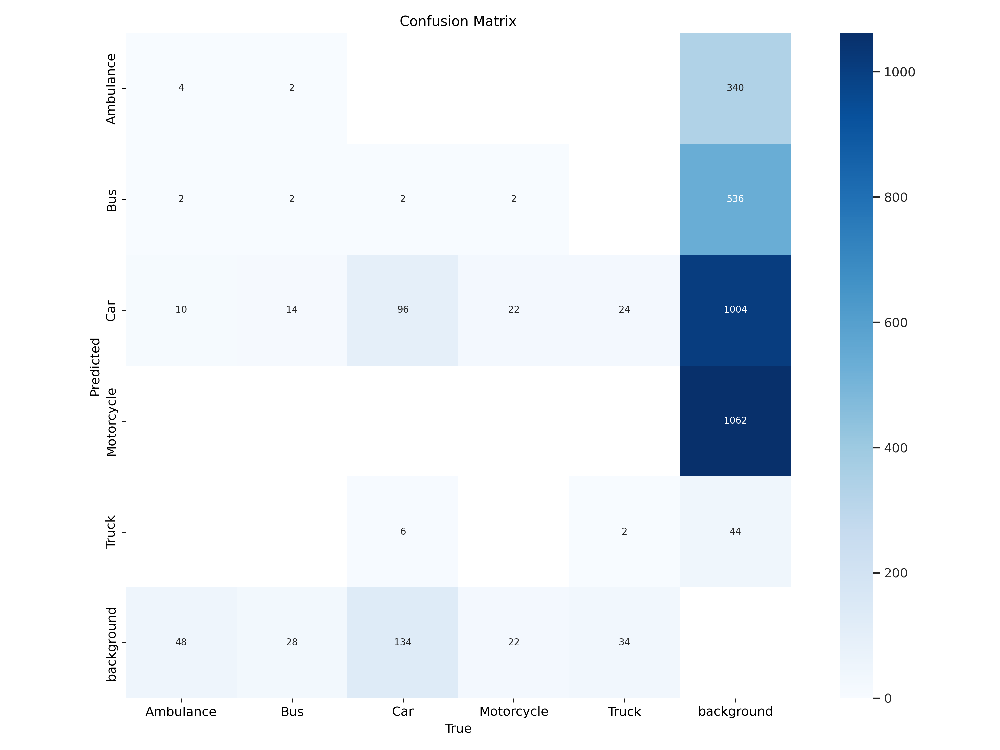

In [10]:
Image(filename=f'runs/detect/train/confusion_matrix.png', width=600)

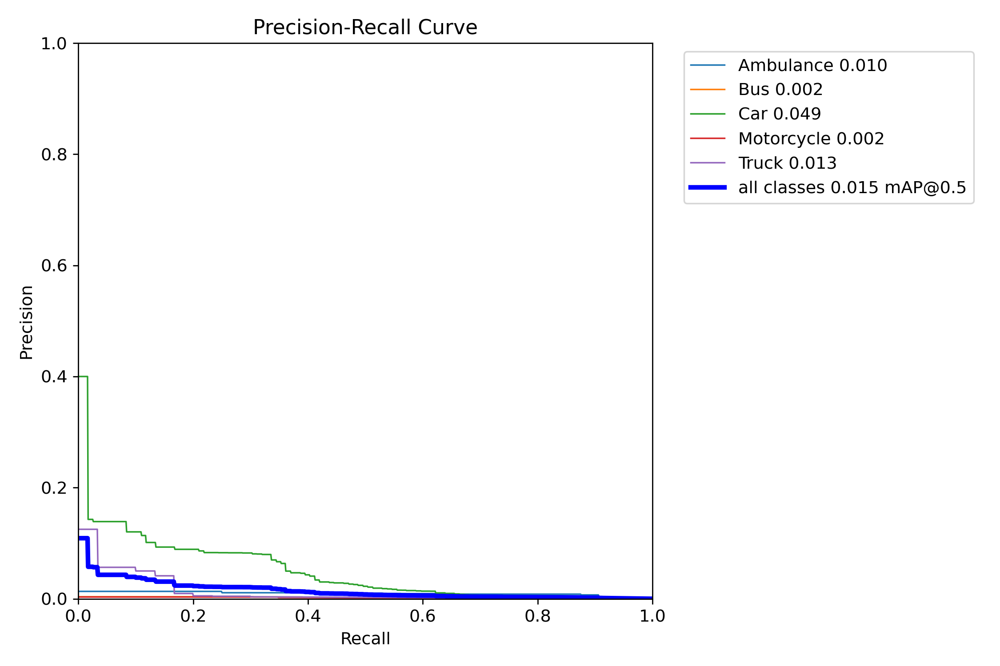

In [11]:
Image(filename=f'runs/detect/train/PR_curve.png', width=600)

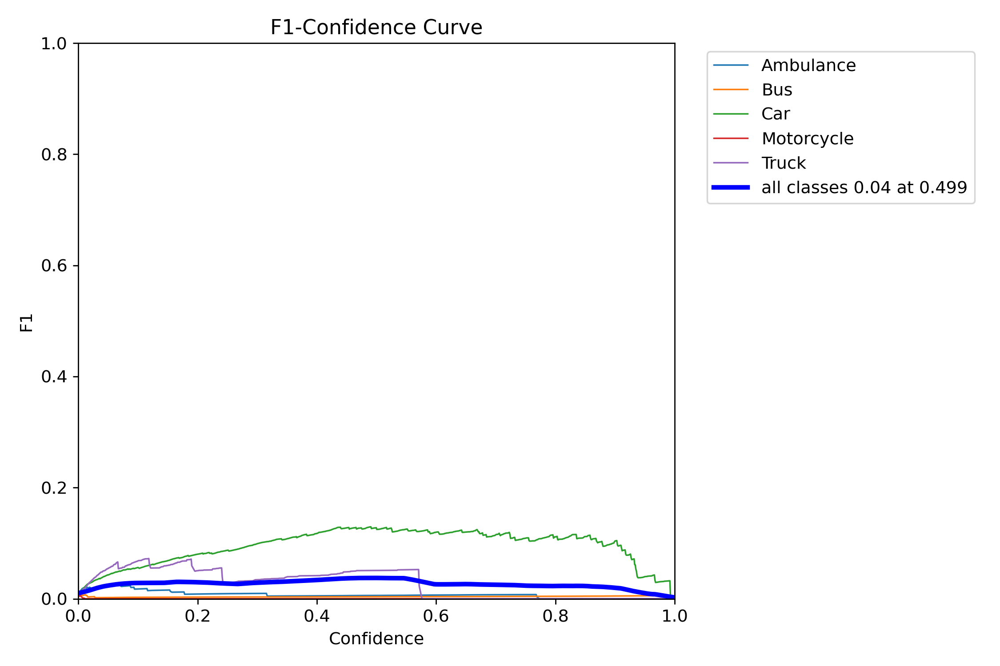

In [12]:
Image(filename=f'runs/detect/train/F1_curve.png', width=600)

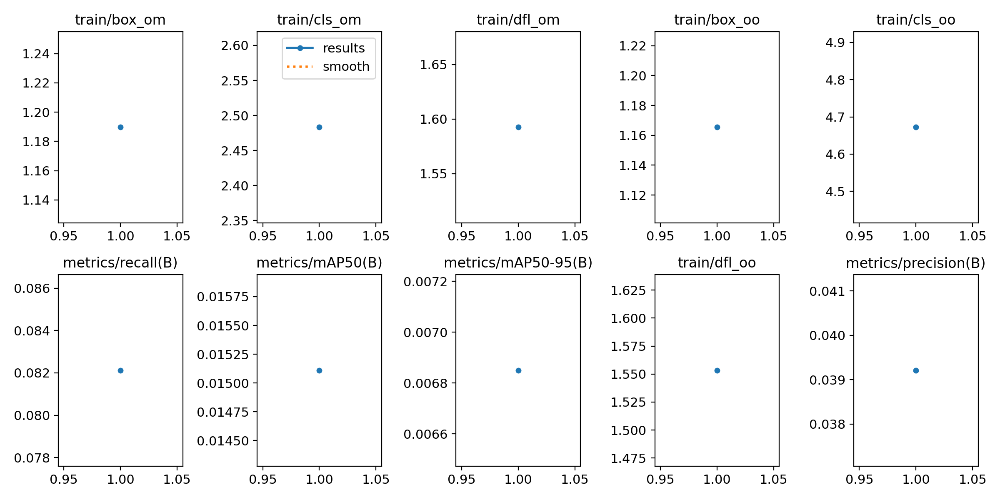

In [13]:
Image(filename=f'runs/detect/train/results.png', width=600)

## Inference with Custom Model on Test Dataset

In [14]:
# Loading test dataset
test_dataset = sv.DetectionDataset.from_yolo(
    images_directory_path='/kaggle/input/vehicledetection/VehiclesDetectionDataset/test/images',
    annotations_directory_path='/kaggle/input/vehicledetection/VehiclesDetectionDataset/test/labels',
    data_yaml_path='/kaggle/working/data.yaml'
)

# Loading trained model
model = YOLOv10(f'runs/detect/train/weights/best.pt')

In [15]:
all_ground_truths = []
all_predictions = []

for image_path in tqdm(test_dataset.images.keys()):
    image = test_dataset.images[image_path]
    
    results = model(source=image, conf=0.25)[0]
    detections = sv.Detections.from_ultralytics(results)
    
    ground_truth = test_dataset.annotations[image_path]
    predictions = np.array([
        [
            box[0],    # x_min
            box[1],    # y_min
            box[2],    # x_max
            box[3],    # y_max
            conf,      # confidence score
            cls_id     # class ID
        ]
        for box, conf, cls_id in zip(detections.xyxy, detections.confidence, detections.class_id)
    ])
    
    all_ground_truths.append(ground_truth)
    all_predictions.append(predictions)

SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.
  0%|          | 0/126 [00:00<?, ?it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 7 Buss, 7 Cars, 20 Motorcycles, 1 Truck, 54.4ms
Speed: 4.9ms preprocess, 54.4ms inference, 120.9ms postprocess per image at shape (1, 3, 640, 640)


  1%|          | 1/126 [00:01<03:08,  1.51s/it]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 28 Ambulances, 39 Buss, 1 Car, 89 Motorcycles, 3 Trucks, 48.5ms
Speed: 3.6ms preprocess, 48.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 2/126 [00:01<01:42,  1.21it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 20 Cars, 48.4ms
Speed: 3.4ms preprocess, 48.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


  2%|▏         | 3/126 [00:02<01:13,  1.67it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 7 Cars, 1 Truck, 48.4ms
Speed: 3.2ms preprocess, 48.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


  3%|▎         | 4/126 [00:02<01:00,  2.01it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 13 Cars, 48.4ms
Speed: 2.9ms preprocess, 48.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


  4%|▍         | 5/126 [00:02<00:52,  2.30it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 4 Cars, 55.4ms
Speed: 2.9ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


  5%|▍         | 6/126 [00:03<00:49,  2.42it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 7 Cars, 55.4ms
Speed: 2.9ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


  6%|▌         | 7/126 [00:03<00:46,  2.57it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 20 Cars, 55.4ms
Speed: 3.0ms preprocess, 55.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


  6%|▋         | 8/126 [00:03<00:43,  2.68it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 3 Buss, 3 Cars, 8 Motorcycles, 55.5ms
Speed: 2.9ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


  7%|▋         | 9/126 [00:04<00:42,  2.77it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 5 Cars, 55.5ms
Speed: 2.8ms preprocess, 55.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


  8%|▊         | 10/126 [00:04<00:41,  2.82it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 4 Cars, 5 Motorcycles, 55.4ms
Speed: 2.6ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


  9%|▊         | 11/126 [00:04<00:40,  2.86it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 5 Cars, 55.5ms
Speed: 3.4ms preprocess, 55.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 10%|▉         | 12/126 [00:05<00:41,  2.75it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 9 Cars, 55.5ms
Speed: 2.7ms preprocess, 55.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 10%|█         | 13/126 [00:05<00:41,  2.73it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 2 Buss, 15 Cars, 1 Truck, 55.4ms
Speed: 3.2ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 11%|█         | 14/126 [00:06<00:39,  2.81it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 3 Buss, 3 Cars, 8 Motorcycles, 55.5ms
Speed: 2.9ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 12%|█▏        | 15/126 [00:06<00:39,  2.83it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Bus, 4 Cars, 55.4ms
Speed: 2.4ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 16/126 [00:06<00:38,  2.89it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 13 Cars, 55.4ms
Speed: 2.4ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 13%|█▎        | 17/126 [00:07<00:37,  2.89it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 2 Cars, 29 Motorcycles, 55.5ms
Speed: 2.5ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 14%|█▍        | 18/126 [00:07<00:37,  2.89it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Bus, 4 Cars, 55.5ms
Speed: 2.5ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 15%|█▌        | 19/126 [00:07<00:36,  2.92it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 5 Cars, 55.5ms
Speed: 3.0ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 16%|█▌        | 20/126 [00:08<00:35,  2.96it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Bus, 4 Cars, 1 Truck, 55.4ms
Speed: 2.6ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 21/126 [00:08<00:35,  2.95it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 6 Cars, 3 Motorcycles, 55.5ms
Speed: 2.5ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 17%|█▋        | 22/126 [00:08<00:36,  2.87it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 2 Ambulances, 2 Buss, 14 Cars, 1 Truck, 55.4ms
Speed: 2.5ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 18%|█▊        | 23/126 [00:09<00:35,  2.86it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 24 Ambulances, 34 Buss, 14 Cars, 49 Motorcycles, 55.6ms
Speed: 2.3ms preprocess, 55.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 19%|█▉        | 24/126 [00:09<00:35,  2.89it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 10 Cars, 1 Motorcycle, 55.4ms
Speed: 3.0ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 20%|█▉        | 25/126 [00:09<00:34,  2.91it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 6 Cars, 55.4ms
Speed: 2.4ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 21%|██        | 26/126 [00:10<00:34,  2.91it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Bus, 5 Cars, 55.5ms
Speed: 2.6ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 21%|██▏       | 27/126 [00:10<00:33,  2.95it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Bus, 9 Cars, 55.4ms
Speed: 3.0ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 22%|██▏       | 28/126 [00:10<00:32,  2.98it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 13 Cars, 1 Truck, 55.4ms
Speed: 2.3ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 23%|██▎       | 29/126 [00:11<00:32,  3.01it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 8 Cars, 55.4ms
Speed: 2.5ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 24%|██▍       | 30/126 [00:11<00:31,  3.04it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 11 Cars, 55.4ms
Speed: 2.4ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▍       | 31/126 [00:11<00:30,  3.06it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 5 Cars, 55.4ms
Speed: 2.8ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 25%|██▌       | 32/126 [00:12<00:30,  3.08it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 10 Cars, 55.5ms
Speed: 3.1ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 26%|██▌       | 33/126 [00:12<00:30,  3.08it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Bus, 6 Cars, 1 Motorcycle, 55.5ms
Speed: 2.9ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 27%|██▋       | 34/126 [00:12<00:29,  3.08it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 15 Cars, 55.4ms
Speed: 2.5ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 28%|██▊       | 35/126 [00:13<00:29,  3.09it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 14 Cars, 55.4ms
Speed: 2.4ms preprocess, 55.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▊       | 36/126 [00:13<00:29,  3.08it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 3 Cars, 55.4ms
Speed: 2.4ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 29%|██▉       | 37/126 [00:13<00:28,  3.09it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 24 Ambulances, 34 Buss, 14 Cars, 49 Motorcycles, 55.6ms
Speed: 2.5ms preprocess, 55.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 30%|███       | 38/126 [00:14<00:28,  3.10it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 8 Cars, 55.4ms
Speed: 2.9ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 31%|███       | 39/126 [00:14<00:27,  3.11it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 5 Cars, 55.5ms
Speed: 2.4ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 32%|███▏      | 40/126 [00:14<00:27,  3.13it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 9 Cars, 55.4ms
Speed: 2.3ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 41/126 [00:14<00:27,  3.11it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 4 Cars, 5 Motorcycles, 55.4ms
Speed: 2.9ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 33%|███▎      | 42/126 [00:15<00:26,  3.11it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 9 Cars, 55.5ms
Speed: 3.6ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 34%|███▍      | 43/126 [00:15<00:26,  3.09it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 1 Bus, 10 Cars, 55.5ms
Speed: 2.9ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 35%|███▍      | 44/126 [00:15<00:26,  3.04it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 16 Cars, 55.4ms
Speed: 2.7ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 36%|███▌      | 45/126 [00:16<00:26,  3.02it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 7 Cars, 55.4ms
Speed: 3.1ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 46/126 [00:16<00:26,  2.96it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 2 Cars, 1 Truck, 55.4ms
Speed: 2.9ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 37%|███▋      | 47/126 [00:16<00:26,  2.95it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 19 Cars, 55.4ms
Speed: 2.9ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 38%|███▊      | 48/126 [00:17<00:26,  2.97it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 4 Cars, 55.4ms
Speed: 2.9ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 39%|███▉      | 49/126 [00:17<00:25,  2.99it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 20 Cars, 55.4ms
Speed: 2.4ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 40%|███▉      | 50/126 [00:17<00:25,  2.99it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 5 Cars, 55.5ms
Speed: 2.4ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 40%|████      | 51/126 [00:18<00:25,  2.97it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 8 Cars, 55.5ms
Speed: 2.6ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 41%|████▏     | 52/126 [00:18<00:24,  3.00it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 16 Cars, 55.4ms
Speed: 2.6ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 42%|████▏     | 53/126 [00:18<00:24,  2.96it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 2 Buss, 8 Cars, 1 Motorcycle, 55.6ms
Speed: 2.5ms preprocess, 55.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 43%|████▎     | 54/126 [00:19<00:24,  2.99it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 6 Cars, 3 Motorcycles, 55.5ms
Speed: 2.4ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▎     | 55/126 [00:19<00:23,  3.00it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 19 Cars, 55.4ms
Speed: 2.4ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 44%|████▍     | 56/126 [00:20<00:23,  2.97it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 11 Cars, 55.5ms
Speed: 3.0ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 45%|████▌     | 57/126 [00:20<00:23,  2.89it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 2 Ambulances, 1 Bus, 7 Cars, 8 Motorcycles, 55.5ms
Speed: 2.6ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 46%|████▌     | 58/126 [00:20<00:23,  2.95it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 5 Cars, 55.4ms
Speed: 3.1ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 47%|████▋     | 59/126 [00:21<00:22,  2.97it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 8 Cars, 55.4ms
Speed: 3.0ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 60/126 [00:21<00:22,  2.97it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 10 Ambulances, 10 Buss, 7 Cars, 22 Motorcycles, 55.7ms
Speed: 2.6ms preprocess, 55.7ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 48%|████▊     | 61/126 [00:21<00:22,  2.91it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 9 Cars, 55.4ms
Speed: 2.9ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 49%|████▉     | 62/126 [00:22<00:21,  2.93it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 5 Cars, 55.4ms
Speed: 2.4ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 50%|█████     | 63/126 [00:22<00:21,  2.98it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 5 Cars, 55.5ms
Speed: 3.1ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 51%|█████     | 64/126 [00:22<00:20,  3.00it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 2 Buss, 8 Cars, 1 Motorcycle, 55.4ms
Speed: 2.4ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 65/126 [00:23<00:19,  3.07it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 12 Cars, 55.4ms
Speed: 2.5ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 52%|█████▏    | 66/126 [00:23<00:19,  3.09it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 14 Cars, 55.4ms
Speed: 2.5ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 53%|█████▎    | 67/126 [00:23<00:19,  3.10it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 9 Cars, 55.4ms
Speed: 2.6ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 54%|█████▍    | 68/126 [00:23<00:18,  3.11it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 9 Cars, 55.4ms
Speed: 2.6ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 55%|█████▍    | 69/126 [00:24<00:18,  3.11it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 8 Cars, 55.4ms
Speed: 2.5ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▌    | 70/126 [00:24<00:18,  3.09it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 7 Cars, 1 Truck, 55.4ms
Speed: 2.9ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 56%|█████▋    | 71/126 [00:24<00:17,  3.10it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 9 Cars, 55.4ms
Speed: 2.5ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 57%|█████▋    | 72/126 [00:25<00:17,  3.15it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 7 Cars, 55.5ms
Speed: 2.7ms preprocess, 55.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


 58%|█████▊    | 73/126 [00:25<00:16,  3.16it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 2 Ambulances, 1 Bus, 7 Cars, 8 Motorcycles, 55.5ms
Speed: 2.5ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 59%|█████▊    | 74/126 [00:25<00:16,  3.10it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Bus, 9 Cars, 55.4ms
Speed: 2.4ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 60%|█████▉    | 75/126 [00:26<00:16,  3.08it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Bus, 5 Cars, 55.5ms
Speed: 2.5ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 60%|██████    | 76/126 [00:26<00:16,  3.10it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 5 Cars, 55.5ms
Speed: 2.6ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 61%|██████    | 77/126 [00:26<00:15,  3.12it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 15 Cars, 55.4ms
Speed: 2.7ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 62%|██████▏   | 78/126 [00:27<00:15,  3.17it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 8 Ambulances, 16 Buss, 4 Cars, 20 Motorcycles, 1 Truck, 55.5ms
Speed: 2.5ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 79/126 [00:27<00:14,  3.20it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 14 Cars, 55.4ms
Speed: 2.7ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 63%|██████▎   | 80/126 [00:27<00:14,  3.20it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 13 Cars, 55.4ms
Speed: 3.0ms preprocess, 55.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 64%|██████▍   | 81/126 [00:28<00:14,  3.15it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 12 Cars, 55.4ms
Speed: 2.5ms preprocess, 55.4ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


 65%|██████▌   | 82/126 [00:28<00:13,  3.17it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 3 Cars, 55.5ms
Speed: 2.4ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 66%|██████▌   | 83/126 [00:28<00:13,  3.16it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 1 Bus, 10 Cars, 55.5ms
Speed: 2.9ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 84/126 [00:29<00:13,  3.12it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 5 Cars, 55.4ms
Speed: 2.6ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 67%|██████▋   | 85/126 [00:29<00:12,  3.17it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 8 Ambulances, 16 Buss, 4 Cars, 20 Motorcycles, 1 Truck, 55.5ms
Speed: 2.5ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 68%|██████▊   | 86/126 [00:29<00:12,  3.15it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 4 Cars, 55.6ms
Speed: 3.4ms preprocess, 55.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 69%|██████▉   | 87/126 [00:30<00:12,  3.10it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 1 Bus, 8 Cars, 1 Truck, 55.4ms
Speed: 2.5ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 70%|██████▉   | 88/126 [00:30<00:12,  3.13it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Bus, 4 Cars, 1 Truck, 55.5ms
Speed: 3.1ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████   | 89/126 [00:30<00:11,  3.13it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 3 Cars, 55.5ms
Speed: 2.5ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 71%|███████▏  | 90/126 [00:30<00:11,  3.13it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 7 Cars, 55.4ms
Speed: 2.5ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 72%|███████▏  | 91/126 [00:31<00:11,  3.14it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 6 Cars, 55.4ms
Speed: 2.5ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 73%|███████▎  | 92/126 [00:31<00:10,  3.18it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 10 Ambulances, 10 Buss, 7 Cars, 22 Motorcycles, 55.5ms
Speed: 2.9ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 74%|███████▍  | 93/126 [00:31<00:10,  3.22it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 4 Cars, 55.4ms
Speed: 2.9ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▍  | 94/126 [00:32<00:09,  3.21it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Bus, 4 Cars, 55.4ms
Speed: 2.9ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 75%|███████▌  | 95/126 [00:32<00:09,  3.23it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 20 Cars, 55.4ms
Speed: 3.0ms preprocess, 55.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 76%|███████▌  | 96/126 [00:32<00:09,  3.25it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 12 Cars, 55.4ms
Speed: 2.4ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 77%|███████▋  | 97/126 [00:33<00:08,  3.24it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 2 Ambulances, 2 Buss, 14 Cars, 1 Truck, 55.4ms
Speed: 3.0ms preprocess, 55.4ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


 78%|███████▊  | 98/126 [00:33<00:08,  3.26it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 14 Cars, 55.4ms
Speed: 3.0ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▊  | 99/126 [00:33<00:08,  3.27it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Bus, 6 Cars, 1 Motorcycle, 55.5ms
Speed: 2.9ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 79%|███████▉  | 100/126 [00:34<00:07,  3.28it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 2 Cars, 29 Motorcycles, 55.5ms
Speed: 2.5ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 80%|████████  | 101/126 [00:34<00:07,  3.28it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 7 Cars, 55.4ms
Speed: 2.9ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 81%|████████  | 102/126 [00:34<00:07,  3.26it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 13 Cars, 55.4ms
Speed: 2.6ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 82%|████████▏ | 103/126 [00:34<00:06,  3.29it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 13 Cars, 1 Truck, 55.5ms
Speed: 3.0ms preprocess, 55.5ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 104/126 [00:35<00:06,  3.29it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 12 Cars, 55.4ms
Speed: 2.4ms preprocess, 55.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 83%|████████▎ | 105/126 [00:35<00:06,  3.29it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 5 Cars, 55.4ms
Speed: 3.1ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 84%|████████▍ | 106/126 [00:35<00:06,  3.25it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 8 Cars, 55.4ms
Speed: 2.9ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 85%|████████▍ | 107/126 [00:36<00:05,  3.21it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 7 Cars, 1 Truck, 55.4ms
Speed: 2.6ms preprocess, 55.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 86%|████████▌ | 108/126 [00:36<00:05,  3.20it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 1 Bus, 5 Cars, 55.5ms
Speed: 2.6ms preprocess, 55.5ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 109/126 [00:36<00:05,  3.07it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 7 Cars, 1 Truck, 55.5ms
Speed: 2.6ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 87%|████████▋ | 110/126 [00:37<00:05,  3.09it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 2 Cars, 1 Truck, 55.4ms
Speed: 3.1ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 88%|████████▊ | 111/126 [00:37<00:04,  3.02it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 1 Bus, 8 Cars, 1 Truck, 55.4ms
Speed: 2.6ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 89%|████████▉ | 112/126 [00:37<00:04,  3.09it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 7 Buss, 7 Cars, 20 Motorcycles, 1 Truck, 55.5ms
Speed: 2.5ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 90%|████████▉ | 113/126 [00:38<00:04,  3.18it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 3 Cars, 55.4ms
Speed: 2.6ms preprocess, 55.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


 90%|█████████ | 114/126 [00:38<00:03,  3.23it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 7 Cars, 55.4ms
Speed: 2.6ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 91%|█████████▏| 115/126 [00:38<00:03,  3.27it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 4 Buss, 9 Cars, 10 Motorcycles, 55.5ms
Speed: 2.6ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 92%|█████████▏| 116/126 [00:39<00:03,  3.30it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 10 Cars, 55.5ms
Speed: 2.5ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 93%|█████████▎| 117/126 [00:39<00:02,  3.28it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Ambulance, 1 Bus, 5 Cars, 55.4ms
Speed: 2.9ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▎| 118/126 [00:39<00:02,  3.25it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 12 Cars, 55.4ms
Speed: 2.4ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 94%|█████████▍| 119/126 [00:39<00:02,  3.26it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 1 Bus, 4 Cars, 55.5ms
Speed: 2.5ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 95%|█████████▌| 120/126 [00:40<00:01,  3.24it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 28 Ambulances, 39 Buss, 1 Car, 89 Motorcycles, 3 Trucks, 55.6ms
Speed: 2.5ms preprocess, 55.6ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 96%|█████████▌| 121/126 [00:40<00:01,  3.28it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 4 Buss, 9 Cars, 10 Motorcycles, 55.5ms
Speed: 2.4ms preprocess, 55.5ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 97%|█████████▋| 122/126 [00:40<00:01,  3.28it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 2 Buss, 15 Cars, 1 Truck, 55.4ms
Speed: 2.4ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 123/126 [00:41<00:00,  3.27it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 10 Cars, 1 Motorcycle, 55.5ms
Speed: 2.6ms preprocess, 55.5ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


 98%|█████████▊| 124/126 [00:41<00:00,  3.28it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 9 Cars, 55.4ms
Speed: 2.4ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


 99%|█████████▉| 125/126 [00:41<00:00,  3.27it/s]SupervisionWarnings: images is deprecated: `DetectionDataset.images` property is deprecated and will be removed in `supervision-0.26.0`. Iterate with `for path, image, annotation in dataset:` instead.



0: 640x640 12 Cars, 55.4ms
Speed: 2.4ms preprocess, 55.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


100%|██████████| 126/126 [00:42<00:00,  2.99it/s]


In [16]:
# Compute Intersection over Union (IoU) between two bounding boxes
def iou(box1, box2):
    x1, y1, x2, y2 = box1
    x1g, y1g, x2g, y2g = box2

    xi1 = max(x1, x1g)
    yi1 = max(y1, y1g)
    xi2 = min(x2, x2g)
    yi2 = min(y2, y2g)

    inter_area = max(xi2 - xi1, 0) * max(yi2 - yi1, 0)

    box1_area = (x2 - x1) * (y2 - y1)
    box2_area = (x2g - x2g) * (y2g - y2g)
    union_area = box1_area + box2_area - inter_area

    return inter_area / union_area if union_area != 0 else 0

In [17]:
y_true = []
y_pred = []

for gt, pred in zip(all_ground_truths, all_predictions):
    gt_labels = gt.class_id
    gt_boxes = gt.xyxy
    
    if pred.size == 0:
        pred = np.empty((0, 6)) 

    if len(gt_labels) > 0:
        for gt_box, gt_label in zip(gt_boxes, gt_labels):
            best_iou = 0
            # Default to -1 if no good match is found
            best_pred_label = -1 
            best_pred_index = -1

            # Iterate over each predicted box to find the best match
            for i, pred_box in enumerate(pred[:, :4]):
                iou_value = iou(gt_box, pred_box)
                if iou_value > best_iou:
                    best_iou = iou_value
                    best_pred_label = int(pred[i, 5])
                    best_pred_index = i
            
            # If a good match is found (assuming IoU threshold of 0.5)
            if best_iou >= 0.5:
                y_true.append(gt_label)
                y_pred.append(best_pred_label)
                
                pred = np.delete(pred, best_pred_index, axis=0)
            else:
                # No match found
                y_true.append(gt_label)
                y_pred.append(-1)

        # Handling remaining predictions that were not matched to any ground truth
        for remaining_pred in pred:
            y_true.append(-1)
            y_pred.append(int(remaining_pred[5]))

print(len(y_true))
print(len(y_pred))

2106
2106


In [18]:
y_true = [label for label in y_true]
y_pred = [label for label in y_pred]

precision = precision_score(y_true, y_pred, average='macro')
recall = recall_score(y_true, y_pred, average='macro')

In [19]:
print(f"Model Evaluation on Test Set")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")

Model Evaluation on Test Set
Precision: 0.0165
Recall: 0.1207


## Inference with Custom Model on Test Video file

In [20]:
bounding_box_annotator = sv.BoundingBoxAnnotator()
label_annotator = sv.LabelAnnotator()

video_path = '/kaggle/input/vehicledetection/TestVideo/TrafficPolice.mp4'
cap = cv2.VideoCapture(video_path)

frame_width = int(cap.get(3))
frame_height = int(cap.get(4))
fps = int(cap.get(cv2.CAP_PROP_FPS))

output_path = 'output_TrafficPolice.mp4'
out = cv2.VideoWriter(output_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (frame_width, frame_height))

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break
    results = model(source=frame, conf=0.25)[0]
    detections = sv.Detections.from_ultralytics(results)

    annotated_frame = bounding_box_annotator.annotate(scene=frame, detections=detections)
    annotated_frame = label_annotator.annotate(scene=annotated_frame, detections=detections)
    
    out.write(annotated_frame)
    
cap.release()
out.release()


0: 384x640 8 Cars, 86.0ms
Speed: 2.3ms preprocess, 86.0ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


SupervisionWarnings: BoundingBoxAnnotator is deprecated: `BoundingBoxAnnotator` is deprecated and has been renamed to `BoxAnnotator`. `BoundingBoxAnnotator` will be removed in supervision-0.26.0.



0: 384x640 1 Bus, 5 Cars, 35.5ms
Speed: 2.3ms preprocess, 35.5ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 6 Cars, 35.5ms
Speed: 1.4ms preprocess, 35.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 6 Cars, 31.5ms
Speed: 1.9ms preprocess, 31.5ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 8 Cars, 1 Truck, 27.5ms
Speed: 1.4ms preprocess, 27.5ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Bus, 7 Cars, 27.5ms
Speed: 1.8ms preprocess, 27.5ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 7 Cars, 27.5ms
Speed: 1.5ms preprocess, 27.5ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Ambulance, 7 Cars, 27.7ms
Speed: 1.9ms preprocess, 27.7ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 7 Cars, 19.9ms
Speed: 1.8ms preprocess, 19.9ms inference, 1.0ms postprocess per imag

In [21]:
# Using ffmpeg to compress the video to display
compressed_output_path = 'compressed_output_TrafficPolice.mp4'
os.system(f'ffmpeg -i {output_path} -vcodec libx264 -crf 28 {compressed_output_path}')

display(Video(compressed_output_path, embed=True))

ffmpeg version 4.2.7-0ubuntu0.1 Copyright (c) 2000-2022 the FFmpeg developers
  built with gcc 9 (Ubuntu 9.4.0-1ubuntu1~20.04.1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-avresample --disable-filter=resample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librsvg --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --e

In [22]:
# !pip install streamlit -q

In [23]:
# !npm install -g localtunnel

In [24]:
# %%writefile app.py
# import streamlit as st
# from PIL import Image
# import cv2
# from tempfile import NamedTemporaryFile
# import requests
# from io import BytesIO
# from ultralytics import YOLOv10
# import supervision as sv

# # Tải mô hình đã huấn luyện
# model = YOLOv10('runs/detect/train/weights/best.pt')

# # Tiêu đề ứng dụng
# st.title('Object Detector')

# # Tùy chọn tải lên
# upload_option = st.radio("Choose an option:", ("Upload File", "Paste Link"))

# # Hàm xử lý ảnh và video
# def process_and_display(img):
#     results = model(source=img, conf=0.25)[0]
#     detections = sv.Detections.from_ultralytics(results)

#     bounding_box_annotator = sv.BoundingBoxAnnotator()
#     label_annotator = sv.LabelAnnotator()

#     annotated_img = bounding_box_annotator.annotate(scene=img, detections=detections)
#     annotated_img = label_annotator.annotate(scene=annotated_img, detections=detections)

#     return annotated_img

# if upload_option == "Upload File":
#     upload_type = st.radio("Choose upload type:", ("Image", "Video"))

#     if upload_type == "Image":
#         uploaded_file = st.file_uploader(label='Upload image here', type=['png', 'jpg', 'jpeg'])
#         if uploaded_file:
#             img = Image.open(uploaded_file)
#             img_np = np.array(img)
#             annotated_img = process_and_display(img_np)
#             st.image(annotated_img, caption="Detected Image", use_column_width=True)

#     elif upload_type == "Video":
#         uploaded_file = st.file_uploader(label='Upload video here', type=['mp4', 'mov'])
#         if uploaded_file:
#             tfile = NamedTemporaryFile(delete=False)
#             tfile.write(uploaded_file.read())

#             vid = cv2.VideoCapture(tfile.name)
#             stframe = st.empty()

#             while vid.isOpened():
#                 ret, frame = vid.read()
#                 if not ret:
#                     break
#                 annotated_frame = process_and_display(frame)
#                 stframe.image(annotated_frame)

#             vid.release()

# elif upload_option == "Paste Link":
#     link = st.text_input("Paste image or video link here")
#     if link:
#         try:
#             response = requests.get(link)
#             response.raise_for_status()

#             content_type = response.headers.get('content-type')

#             if 'image' in content_type:
#                 img = Image.open(BytesIO(response.content))
#                 img_np = np.array(img)
#                 annotated_img = process_and_display(img_np)
#                 st.image(annotated_img, caption="Image from Link", use_column_width=True)

#             elif 'video' in content_type:
#                 if not any(ext in link for ext in ['.mp4', '.mov', '.avi']):
#                     st.error("Unsupported video format. Please provide a direct link to an MP4, MOV, or AVI video.")
#                 else:
#                     st.write("Video from Link (implementation needed)")

#             elif "youtube.com" in link or "youtu.be" in link:
#                 yt = YouTube(link)
#                 stream = yt.streams.get_highest_resolution()

#                 with NamedTemporaryFile(delete=False) as tfile:
#                     stream.download(output_path="", filename=tfile.name)
#                     video_path = tfile.name

#                 vid = cv2.VideoCapture(video_path)
#                 stframe = st.empty()

#                 while vid.isOpened():
#                     ret, frame = vid.read()
#                     if not ret:
#                         break
#                     annotated_frame = process_and_display(frame)
#                     stframe.image(annotated_frame)

#                 vid.release()

#             else:
#                 st.error("Invalid link. Please provide a valid image or video link.")

#         except requests.exceptions.RequestException as e:
#             st.error(f"Error fetching content: {e}")


In [25]:
# !streamlit run app.py & npx localtunnel --port 8501